Mounting the Google drive



In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


Cloning the GitHub repository

In [ ]:
!git clone https://github.com/NishantPatel18/RoadCrackDetection.git

Cloning into 'RoadCrackDetection'...
remote: Enumerating objects: 887, done.
remote: Counting objects: 100% (887/887), done.
remote: Compressing objects: 100% (612/612), done.
remote: Total 121386 (delta 379), reused 779 (delta 274), pack-reused 120499
Receiving objects: 100% (121386/121386), 2.63 GiB | 42.42 MiB/s, done.
Resolving deltas: 100% (10129/10129), done.
Checking out files: 100% (220639/220639), done.


Training

In [ ]:
%cd /content/RoadCrackDetection/RDDC_ObjectDetection/Pytorch_OD

import os
import numpy as np
import torch
import torch.utils.data
from PIL import Image
import pandas as pd

import torchvision
from torchvision.models.detection.faster_rcnn import FastRCNNPredictor
from engine import train_one_epoch, evaluate
import utils
import transforms as T


def parse_one_annot(path_to_data_file, filename):
    data = pd.read_csv(path_to_data_file)
    boxes_array = data[data["filename"] == filename][["xmin", "ymin", "xmax", "ymax"]].values
    class_name = data[data["filename"] == filename][["class"]].values

    return boxes_array, class_name


def get_class_number(class_input):
    class_number = 0
    if (class_input == ['D00']):
        class_number = 1
    elif (class_input == ['D01']):
        class_number = 2
    elif (class_input == ['D10']):
        class_number = 3
    elif (class_input == ['D11']):
        class_number = 4
    elif (class_input == ['D20']):
        class_number = 5
    elif (class_input == ['D30']):
        class_number = 6
    elif (class_input == ['D40']):
        class_number = 7
    elif (class_input == ['D43']):
        class_number = 8
    elif (class_input == ['D44']):
        class_number = 9
    else:
        class_number = 0

    return class_number


class RaccoonDataset(torch.utils.data.Dataset):
    def __init__(self, root, data_file, transforms=None):
        self.root = root
        self.transforms = transforms
        self.imgs = sorted(os.listdir(os.path.join(root)))
        self.path_to_data_file = data_file

    def __getitem__(self, idx):
        # load images and bounding boxes
        img_path = os.path.join(self.root, self.imgs[idx])
        img = Image.open(img_path).convert("RGB")
        box_list, class_name = parse_one_annot(self.path_to_data_file,
                                               self.imgs[idx])
        boxes = torch.as_tensor(box_list, dtype=torch.float32)
        num_objs = len(box_list)
        class_list = []
        # print(class_name)

        for name in class_name:
            # print(name)
            number = get_class_number(name)
            # print(number)
            class_list.append(number)

        # print(class_list)
        class_list_numpy = np.array(class_list)
        labels = torch.as_tensor(class_list_numpy, dtype=torch.int64)
        # labels = torch.ones((num_objs,), dtype=torch.int64)
        image_id = torch.tensor([idx])
        area = (boxes[:, 3] - boxes[:, 1]) * (boxes[:, 2] - boxes[:, 0])
        # suppose all instances are not crowd
        iscrowd = torch.zeros((num_objs,), dtype=torch.int64)
        target = {}
        target["boxes"] = boxes
        target["labels"] = labels
        target["image_id"] = image_id
        target["area"] = area
        target["iscrowd"] = iscrowd
        # print(target)

        if self.transforms is not None:
            img, target = self.transforms(img, target)

        return img, target

    def __len__(self):
        return len(self.imgs)


dataset = RaccoonDataset(root="/content/RoadCrackDetection/RDDC_ObjectDetection/RoadDamageDataset/All_cities/Images",
                         data_file="/content/RoadCrackDetection/RDDC_ObjectDetection/Pytorch_OD/all_cities.csv")
dataset.__getitem__(0)


def get_model(num_classes):
    # load an object detection model pre-trained on COCO
    model = torchvision.models.detection.fasterrcnn_resnet50_fpn(pretrained=True)
    # get the number of input features for the classifier
    in_features = model.roi_heads.box_predictor.cls_score.in_features
    # replace the pre-trained head with a new on
    model.roi_heads.box_predictor = FastRCNNPredictor(in_features, num_classes)

    return model


def get_transform(train):
    transforms = []
    # converts the image, a PIL image, into a PyTorch Tensor
    transforms.append(T.ToTensor())
    if train:
        # during training, randomly flip the training images
        # and ground-truth for data augmentation
        transforms.append(T.RandomHorizontalFlip(0.5))
    return T.Compose(transforms)


# use our dataset and defined transformations
dataset = RaccoonDataset(root="/content/RoadCrackDetection/RDDC_ObjectDetection/RoadDamageDataset/All_cities/Images",
                         data_file="/content/RoadCrackDetection/RDDC_ObjectDetection/Pytorch_OD/all_cities.csv",
                         transforms=get_transform(train=True))

dataset_test = RaccoonDataset(
    root="/content/RoadCrackDetection/RDDC_ObjectDetection/RoadDamageDataset/All_cities/Images",
    data_file="/content/RoadCrackDetection/RDDC_ObjectDetection/Pytorch_OD/all_cities.csv",
    transforms=get_transform(train=False))

# split the dataset in train and test set
torch.manual_seed(1)
num_total_for_train_test = 9892
# 30%
# num_test = 2968
num_test = 50
num_train = num_total_for_train_test - num_test
indices = torch.randperm(len(dataset)).tolist()
dataset = torch.utils.data.Subset(dataset, indices[:num_train])
dataset_test = torch.utils.data.Subset(dataset_test, indices[num_train:])

# define training and validation data loaders
data_loader = torch.utils.data.DataLoader(dataset, batch_size=14, shuffle=True, num_workers=4,
                                          collate_fn=utils.collate_fn)

data_loader_test = torch.utils.data.DataLoader(dataset_test, batch_size=14, shuffle=False, num_workers=4,
                                               collate_fn=utils.collate_fn)

print("We have: {} examples, {} are training and {} are testing".format(len(indices), len(dataset), len(dataset_test)))

device = torch.device('cuda')

# our dataset has two classes only - raccoon and not racoon
num_classes = 10

# get the model using our helper function
model = get_model(num_classes)

# move model to the right device
model.to(device)

# construct an optimizer
params = [p for p in model.parameters() if p.requires_grad]
optimizer = torch.optim.SGD(params, lr=0.005, momentum=0.9, weight_decay=0.0005)

# and a learning rate scheduler which decreases the learning rate by
# 10x every 3 epochs
lr_scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=3, gamma=0.1)

# let's train it for 10 epochs
num_epochs = 10

for epoch in range(num_epochs):
    # train for one epoch, printing every 10 iterations
    # change print freq to display 1 by 1
    train_one_epoch(model, optimizer, data_loader, device, epoch, print_freq=10)

    # update the learning rate
    lr_scheduler.step()

    # evaluate on the test dataset
    evaluate(model, data_loader_test, device=device)

to save model
torch.save(model.state_dict(), "/content/RoadCrackDetection/RDDC_ObjectDetection/Pytorch_OD/road_crack/model")

/content/RoadCrackDetection/RDDC_ObjectDetection/Pytorch_OD
We have: 9892 examples, 9842 are training and 50 are testing


Testing

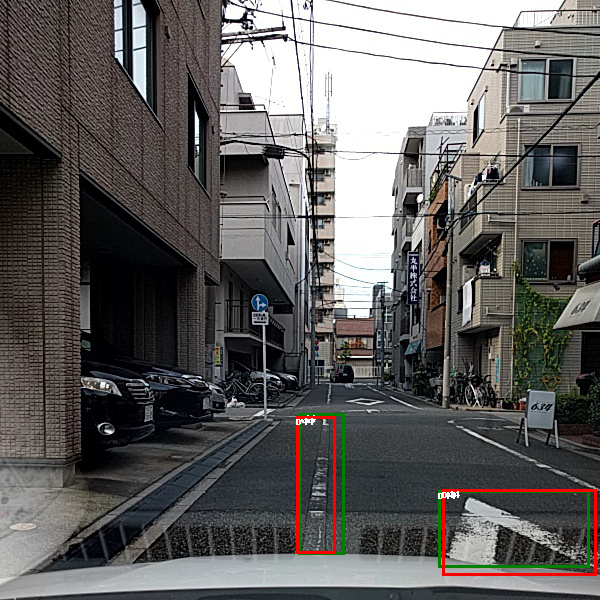

There are 3 road cracks in this image
TP 2
FP 1
FN 0
TN 8
Infer Time is 5.13 second
1 prediction is done
IOUs of the bounding boxes of detected cracks are
IOU: 0.7769
IOU: 0.8346
-----------------------------------------------------------------------------


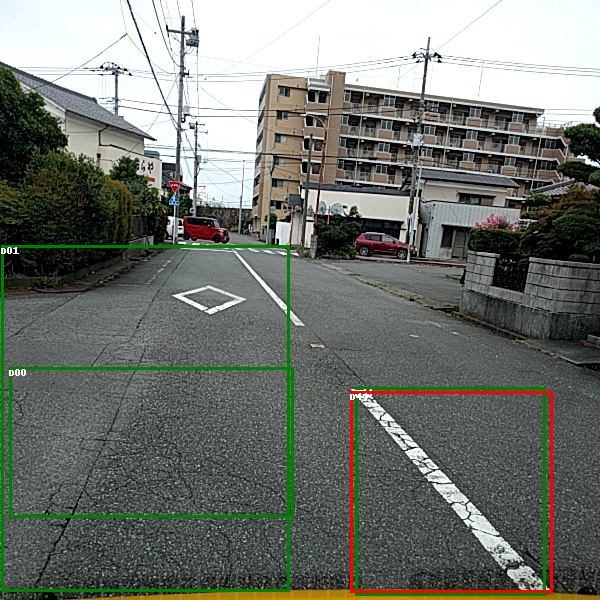

There are 2 road cracks in this image
TP 1
FP 1
FN 2
TN 13
Infer Time is 5.20 second
2 predictions are done
IOU of the bounding box of detected crack is
IOU: 0.9118
-----------------------------------------------------------------------------


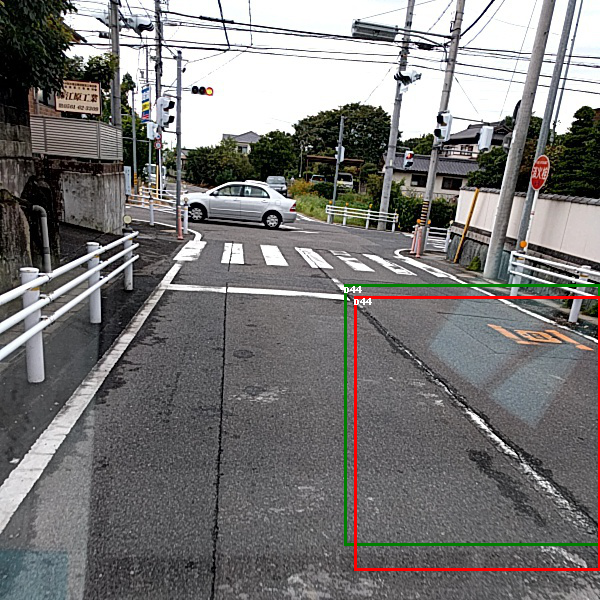

There are 3 road cracks in this image
TP 1
FP 2
FN 0
TN 5
Infer Time is 5.11 second
3 predictions are done
IOU of the bounding box of detected crack is
IOU: 0.834
-----------------------------------------------------------------------------


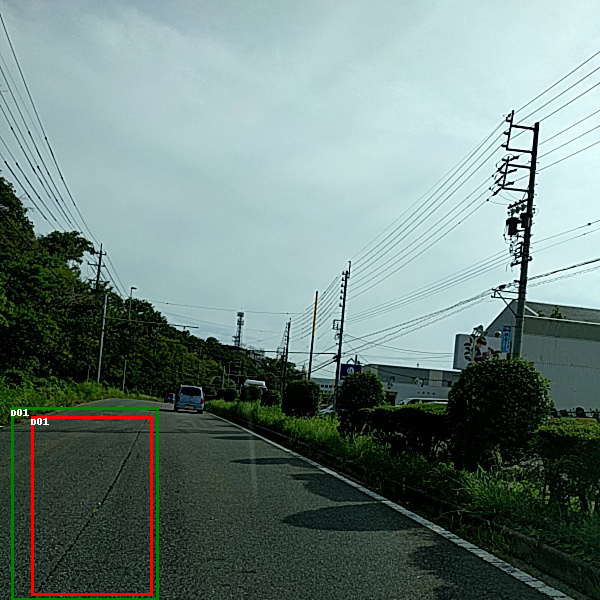

There is 1 road crack in this image
TP 1
FP 0
FN 0
TN 4
Infer Time is 5.09 second
4 predictions are done
IOU of the bounding box of detected crack is
IOU: 0.7694
-----------------------------------------------------------------------------


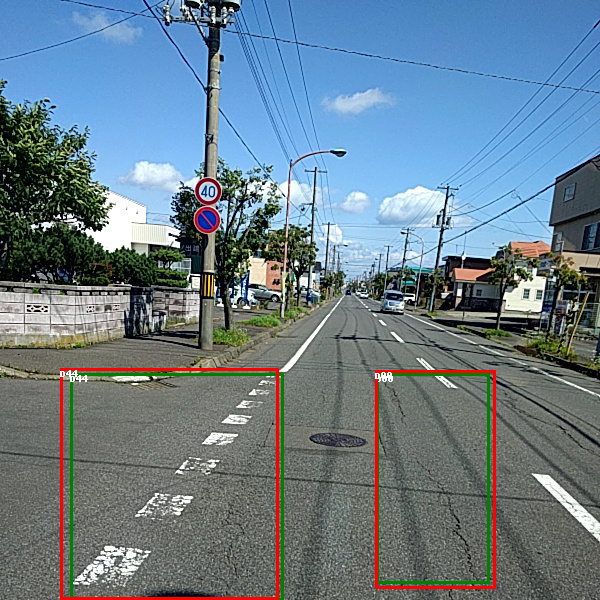

There are 3 road cracks in this image
TP 2
FP 1
FN 0
TN 17
Infer Time is 5.04 second
5 predictions are done
IOUs of the bounding boxes of detected cracks are
IOU: 0.9219
IOU: 0.9141
-----------------------------------------------------------------------------


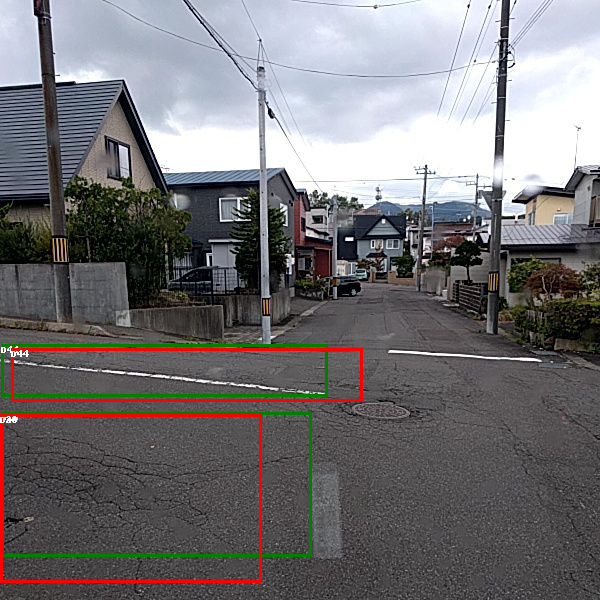

There are 3 road cracks in this image
TP 2
FP 1
FN 0
TN 12
Infer Time is 5.08 second
6 predictions are done
IOUs of the bounding boxes of detected cracks are
IOU: 0.716
IOU: 0.7335
-----------------------------------------------------------------------------


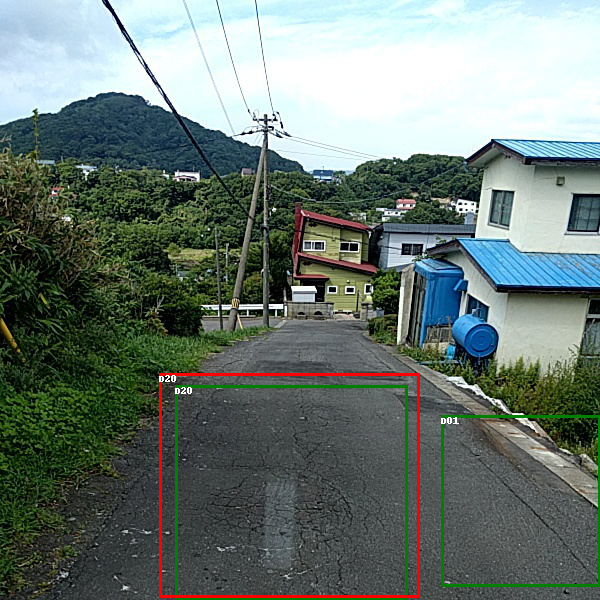

There is 1 road crack in this image
TP 1
FP 0
FN 1
TN 4
Infer Time is 5.11 second
7 predictions are done
IOU of the bounding box of detected crack is
IOU: 0.8399
-----------------------------------------------------------------------------


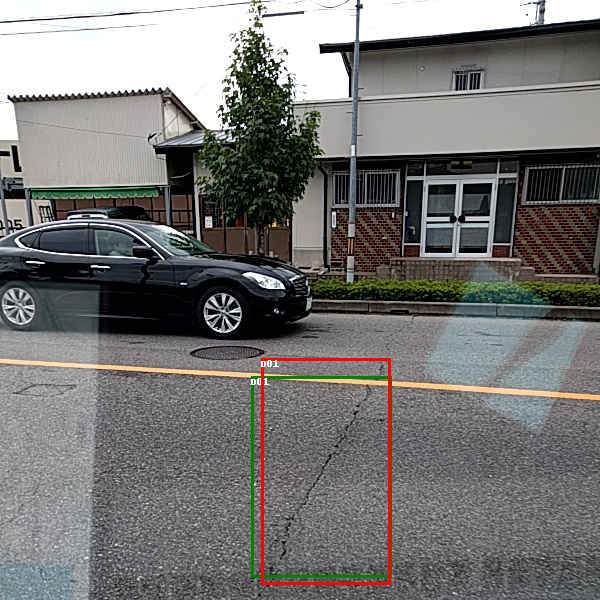

There is 1 road crack in this image
TP 1
FP 0
FN 0
TN 2
Infer Time is 5.08 second
8 predictions are done
IOU of the bounding box of detected crack is
IOU: 0.8259
-----------------------------------------------------------------------------


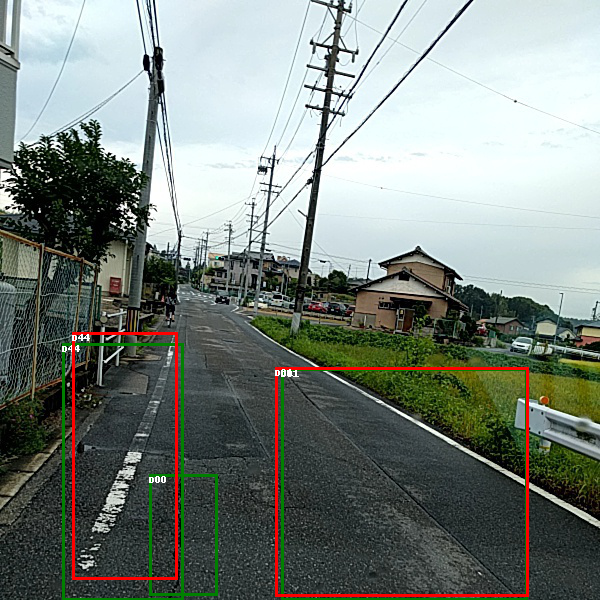

There are 2 road cracks in this image
TP 2
FP 0
FN 1
TN 18
Infer Time is 5.07 second
9 predictions are done
IOUs of the bounding boxes of detected cracks are
IOU: 0.7733
IOU: 0.9547
-----------------------------------------------------------------------------


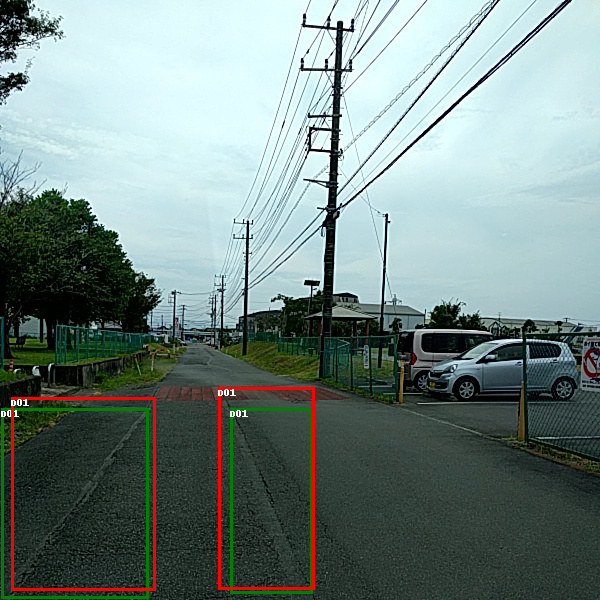

There are 2 road cracks in this image
TP 2
FP 0
FN 0
TN 8
Infer Time is 5.03 second
10 predictions are done
IOUs of the bounding boxes of detected cracks are
IOU: 0.762
IOU: 0.8101
-----------------------------------------------------------------------------


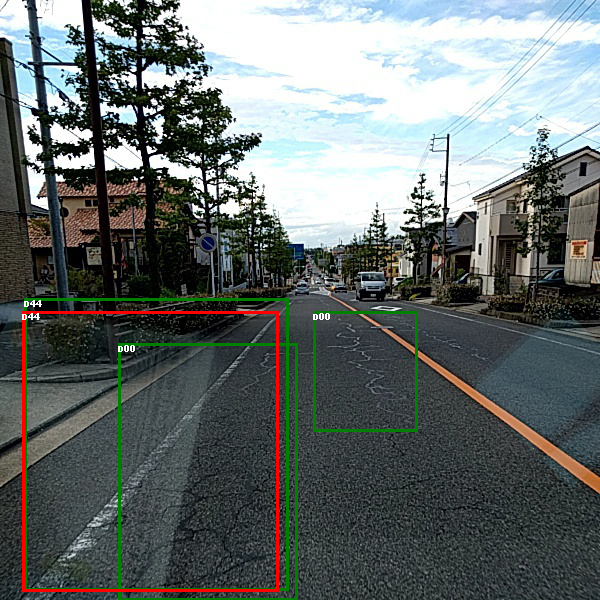

There is 1 road crack in this image
TP 1
FP 0
FN 2
TN 13
Infer Time is 5.00 second
11 predictions are done
IOU of the bounding box of detected crack is
IOU: 0.9084
-----------------------------------------------------------------------------


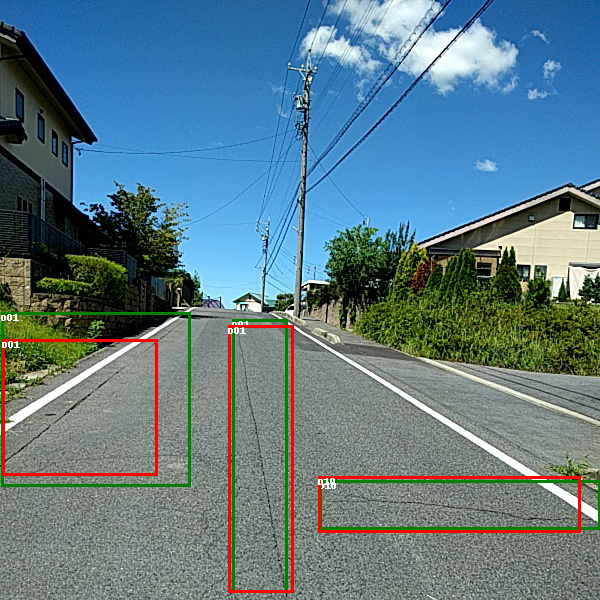

There are 3 road cracks in this image
TP 3
FP 0
FN 0
TN 9
Infer Time is 5.19 second
12 predictions are done
IOUs of the bounding boxes of detected cracks are
IOU: 0.8305
IOU: 0.645
IOU: 0.8326
-----------------------------------------------------------------------------


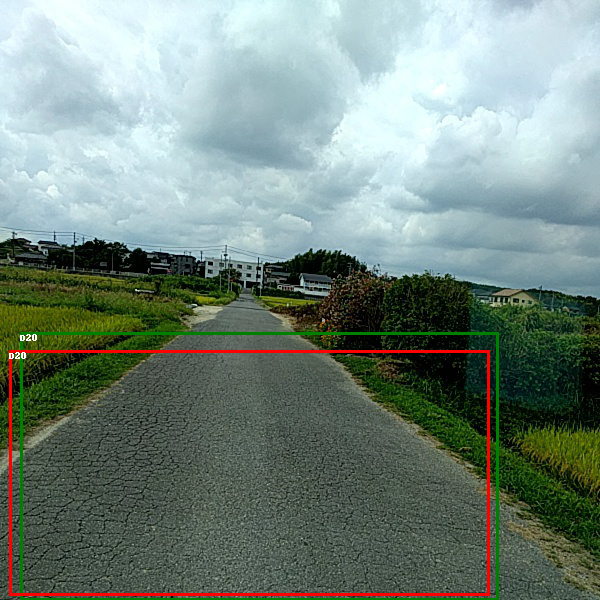

There are 3 road cracks in this image
TP 1
FP 2
FN 0
TN 16
Infer Time is 5.04 second
13 predictions are done
IOU of the bounding box of detected crack is
IOU: 0.8786
-----------------------------------------------------------------------------


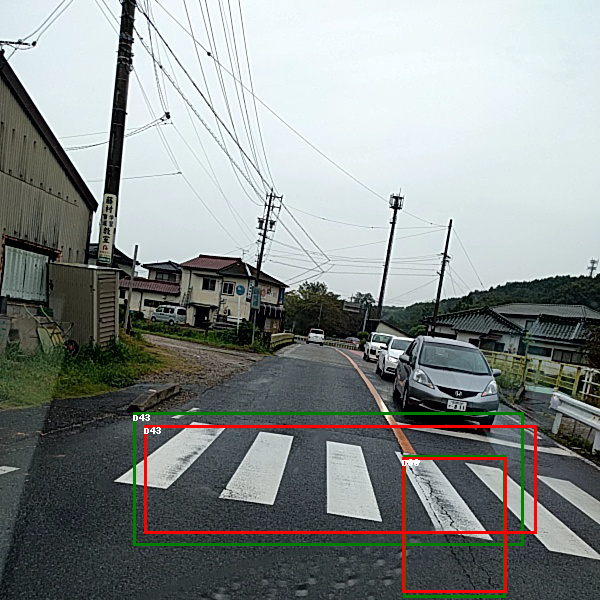

There are 2 road cracks in this image
TP 2
FP 0
FN 0
TN 9
Infer Time is 5.09 second
14 predictions are done
IOUs of the bounding boxes of detected cracks are
IOU: 0.9316
IOU: 0.766
-----------------------------------------------------------------------------


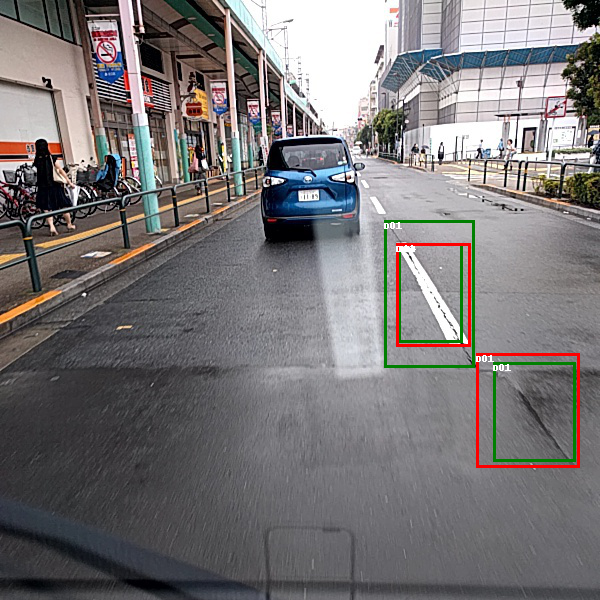

There are 3 road cracks in this image
TP 2
FP 1
FN 1
TN 12
Infer Time is 5.07 second
15 predictions are done
IOUs of the bounding boxes of detected cracks are
IOU: 0.8274
IOU: 0.6901
-----------------------------------------------------------------------------


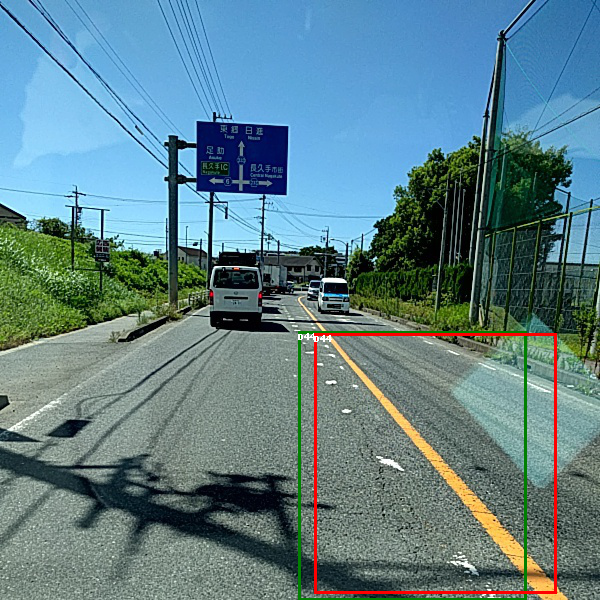

There are 2 road cracks in this image
TP 1
FP 1
FN 0
TN 13
Infer Time is 5.06 second
16 predictions are done
IOU of the bounding box of detected crack is
IOU: 0.7961
-----------------------------------------------------------------------------


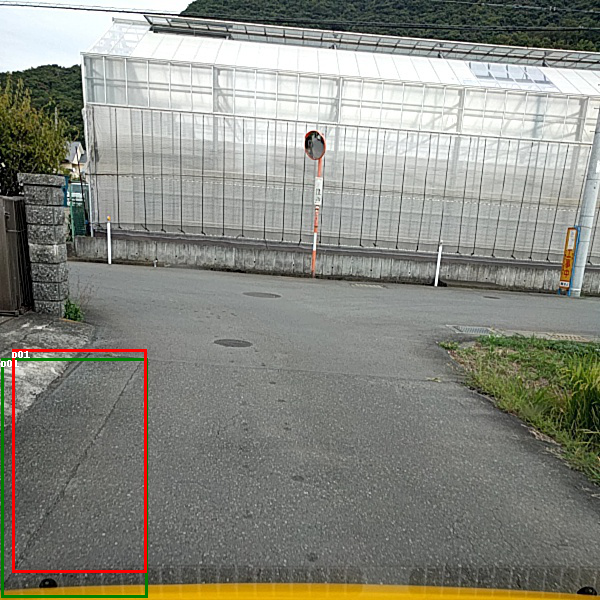

There is 1 road crack in this image
TP 1
FP 0
FN 0
TN 3
Infer Time is 5.11 second
17 predictions are done
IOU of the bounding box of detected crack is
IOU: 0.7986
-----------------------------------------------------------------------------


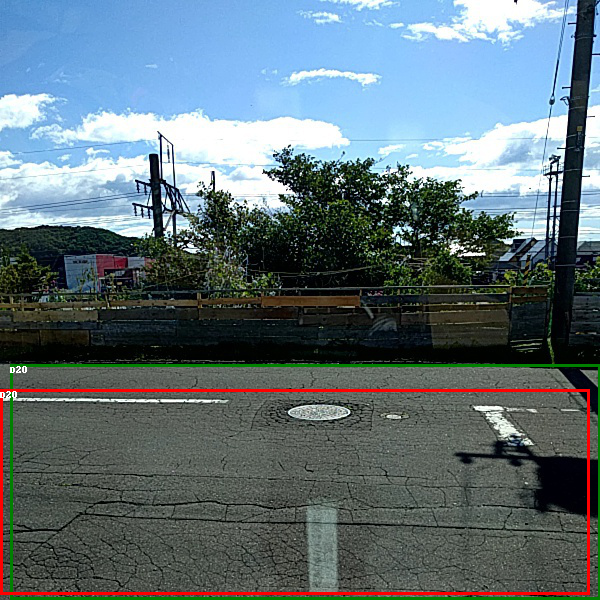

There is 1 road crack in this image
TP 1
FP 0
FN 0
TN 5
Infer Time is 5.07 second
18 predictions are done
IOU of the bounding box of detected crack is
IOU: 0.8465
-----------------------------------------------------------------------------


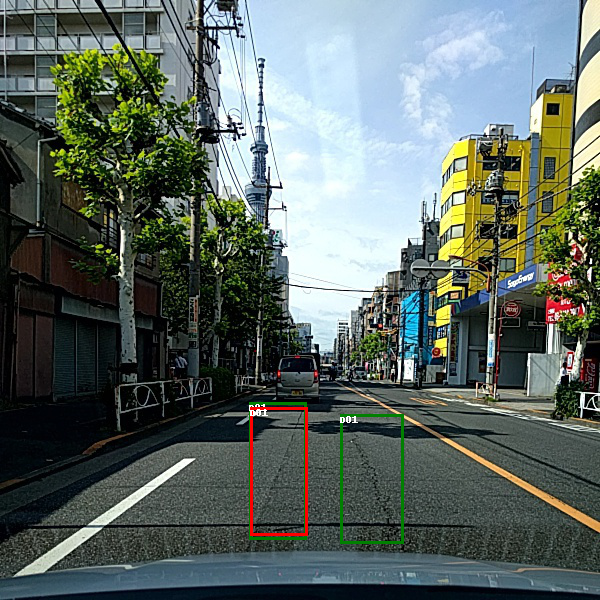

There are 3 road cracks in this image
TP 1
FP 2
FN 1
TN 5
Infer Time is 5.10 second
19 predictions are done
IOU of the bounding box of detected crack is
IOU: 0.8795
-----------------------------------------------------------------------------


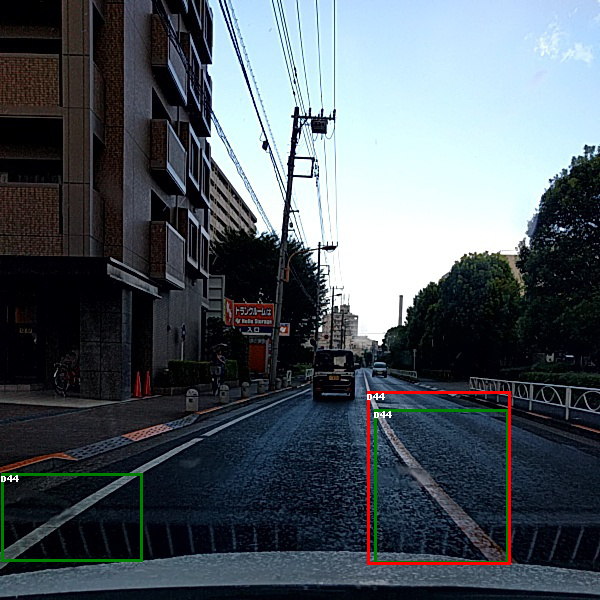

There is 1 road crack in this image
TP 1
FP 0
FN 1
TN 1
Infer Time is 5.05 second
20 predictions are done
IOU of the bounding box of detected crack is
IOU: 0.8394
-----------------------------------------------------------------------------


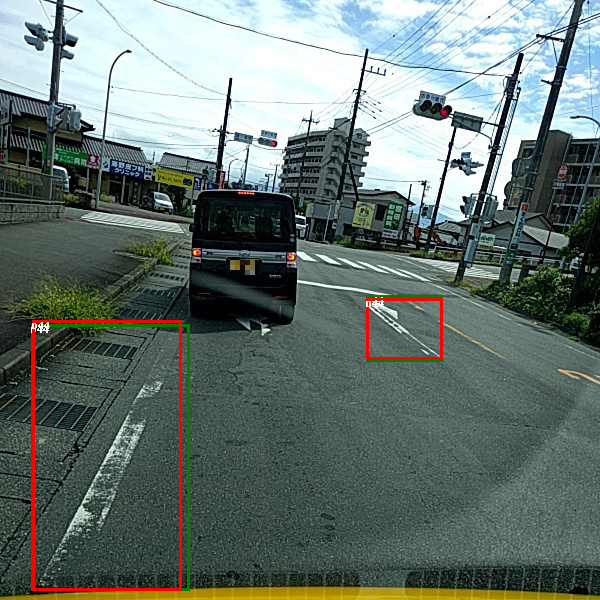

There are 2 road cracks in this image
TP 2
FP 0
FN 0
TN 5
Infer Time is 5.08 second
21 predictions are done
IOUs of the bounding boxes of detected cracks are
IOU: 0.9332
IOU: 0.9112
-----------------------------------------------------------------------------


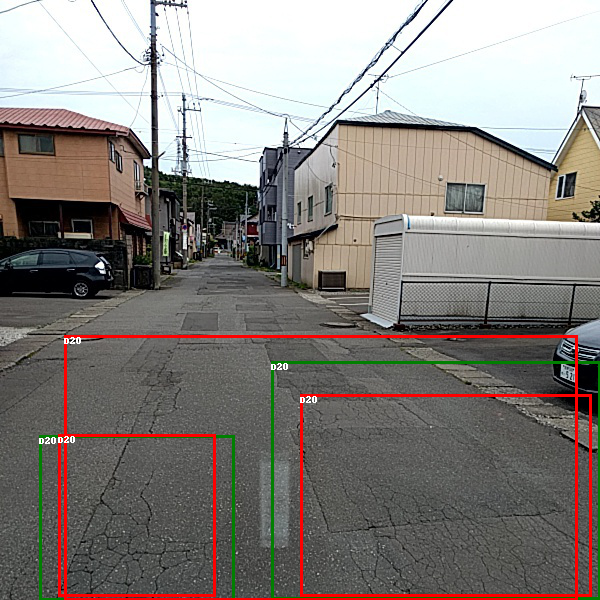

There are 3 road cracks in this image
TP 2
FP 1
FN 0
TN 14
Infer Time is 5.06 second
22 predictions are done
IOUs of the bounding boxes of detected cracks are
IOU: 0.7523
IOU: 0.5178
IOU: 0.7916
-----------------------------------------------------------------------------


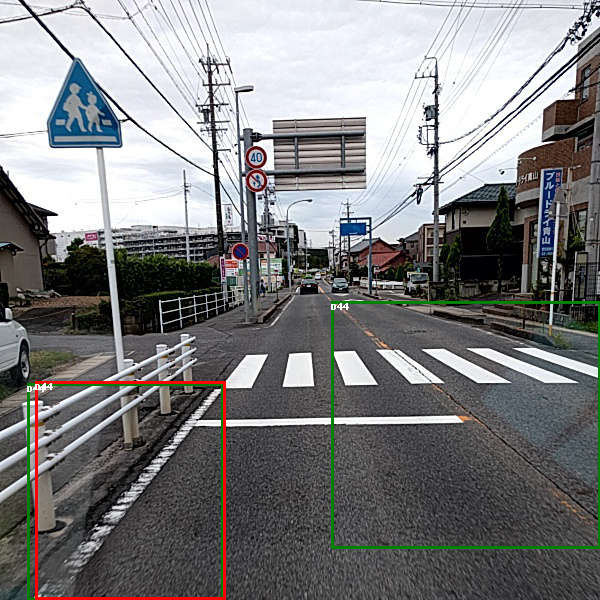

There are 2 road cracks in this image
TP 1
FP 1
FN 1
TN 7
Infer Time is 5.05 second
23 predictions are done
IOU of the bounding box of detected crack is
IOU: 0.9394
-----------------------------------------------------------------------------


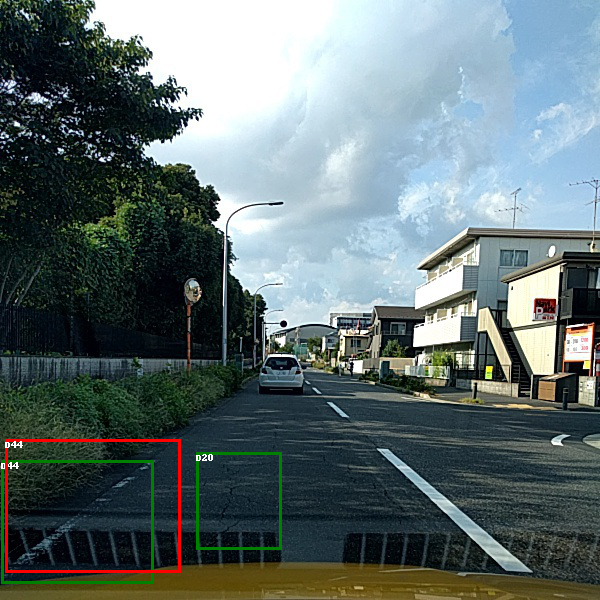

There are 2 road cracks in this image
TP 1
FP 1
FN 1
TN 15
Infer Time is 5.05 second
24 predictions are done
IOU of the bounding box of detected crack is
IOU: 0.6558
-----------------------------------------------------------------------------


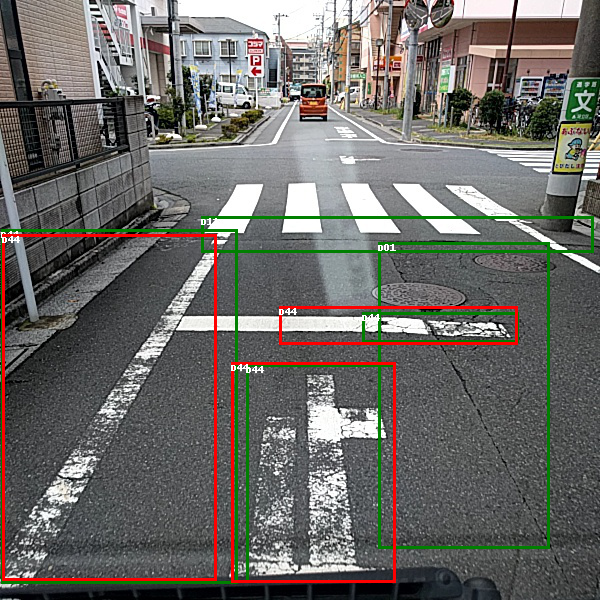

There are 5 road cracks in this image
TP 3
FP 2
FN 2
TN 22
Infer Time is 5.10 second
25 predictions are done
IOUs of the bounding boxes of detected cracks are
IOU: 0.8868
IOU: 0.8955
IOU: 0.5179
-----------------------------------------------------------------------------


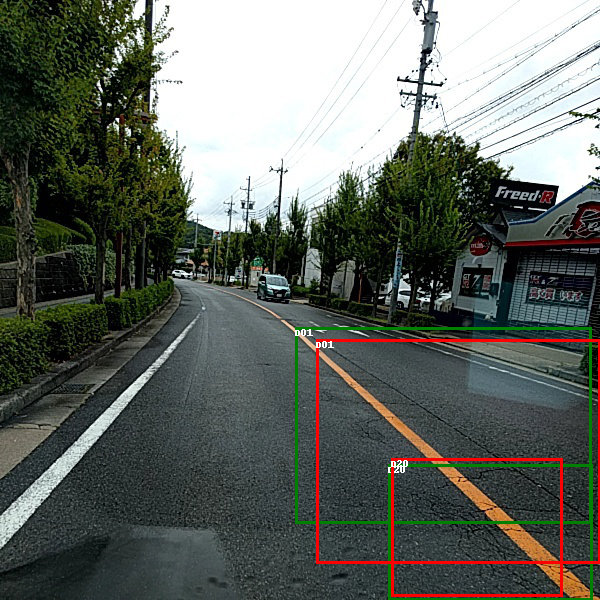

There are 2 road cracks in this image
TP 2
FP 0
FN 0
TN 14
Infer Time is 5.05 second
26 predictions are done
IOUs of the bounding boxes of detected cracks are
IOU: 0.7896
IOU: 0.7083
-----------------------------------------------------------------------------


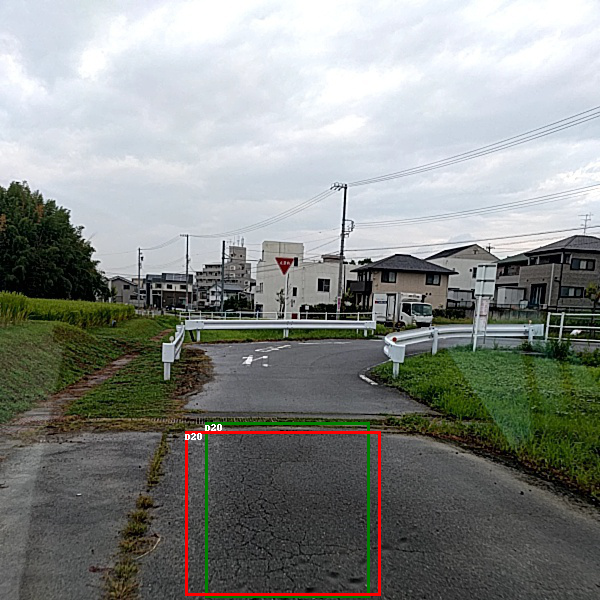

There is 1 road crack in this image
TP 1
FP 0
FN 0
TN 2
Infer Time is 5.07 second
27 predictions are done
IOU of the bounding box of detected crack is
IOU: 0.7969
-----------------------------------------------------------------------------


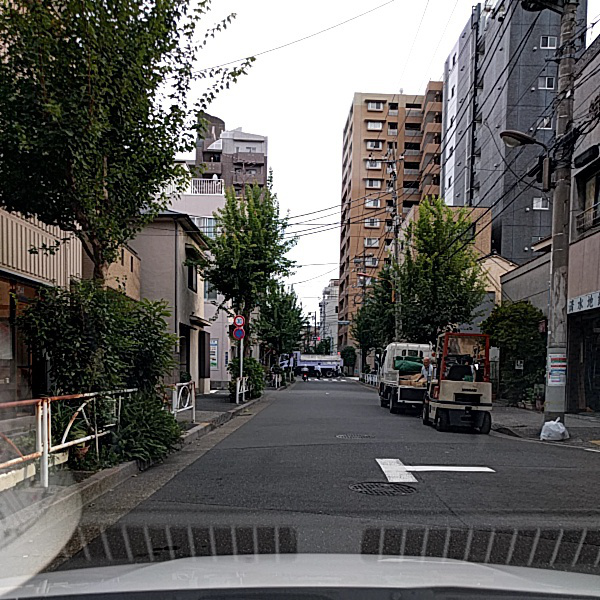

There is no crack
TP 0
FP 0
FN 0
TN 9
Infer Time is 5.06 second
28 predictions are done
-----------------------------------------------------------------------------


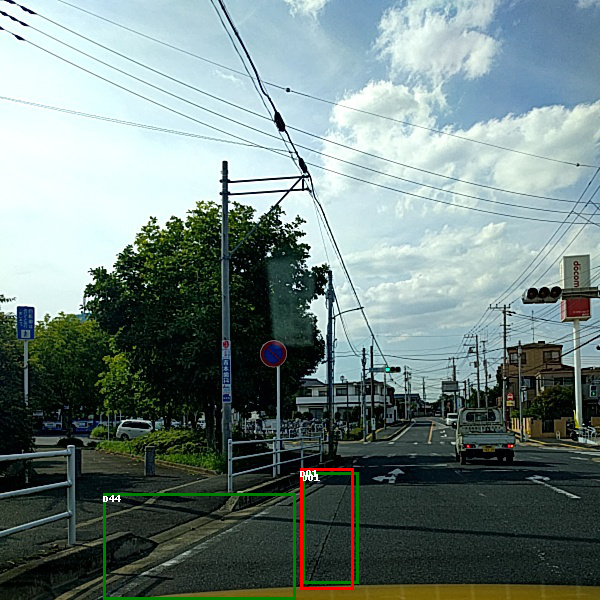

There is 1 road crack in this image
TP 1
FP 0
FN 1
TN 2
Infer Time is 5.02 second
29 predictions are done
IOU of the bounding box of detected crack is
IOU: 0.8285
-----------------------------------------------------------------------------


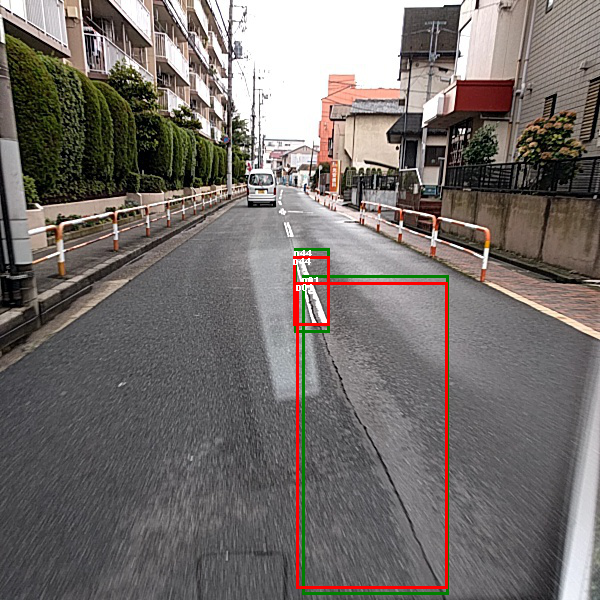

There are 2 road cracks in this image
TP 2
FP 0
FN 0
TN 2
Infer Time is 5.07 second
30 predictions are done
IOUs of the bounding boxes of detected cracks are
IOU: 0.9206
IOU: 0.7996
-----------------------------------------------------------------------------


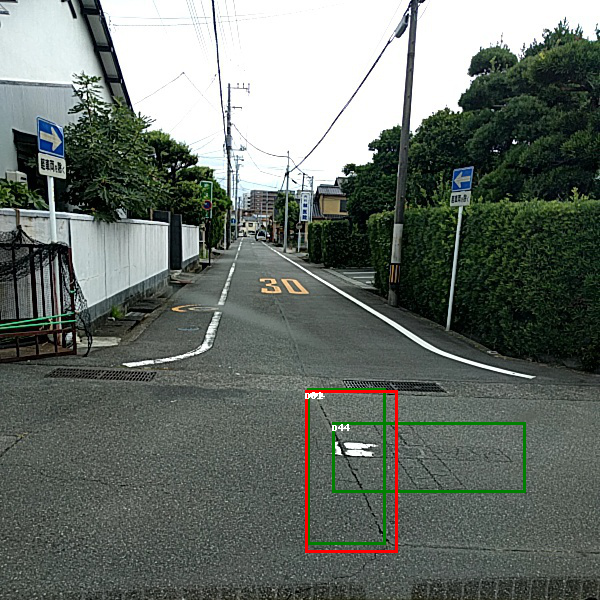

There are 2 road cracks in this image
TP 1
FP 1
FN 1
TN 25
Infer Time is 5.14 second
31 predictions are done
IOU of the bounding box of detected crack is
IOU: 0.7883
-----------------------------------------------------------------------------


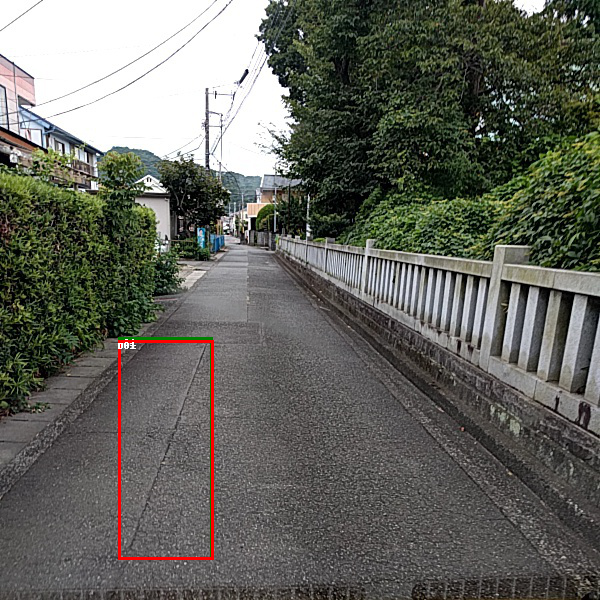

There is 1 road crack in this image
TP 1
FP 0
FN 0
TN 0
Infer Time is 5.14 second
32 predictions are done
IOU of the bounding box of detected crack is
IOU: 0.965
-----------------------------------------------------------------------------


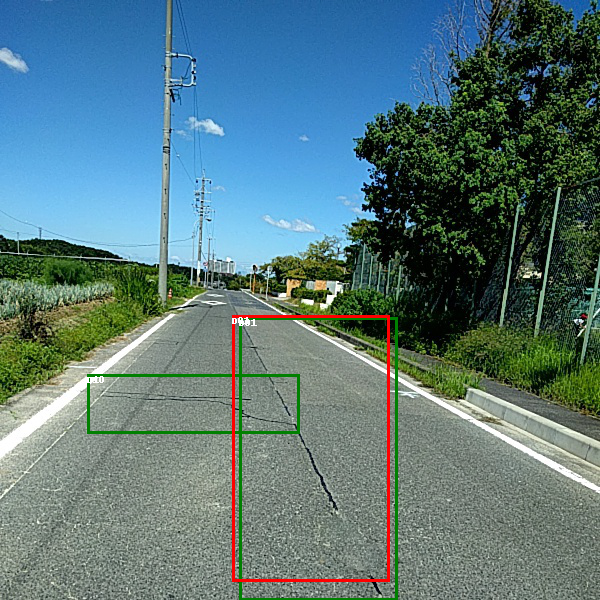

There are 2 road cracks in this image
TP 1
FP 1
FN 1
TN 16
Infer Time is 5.16 second
33 predictions are done
IOU of the bounding box of detected crack is
IOU: 0.8548
-----------------------------------------------------------------------------


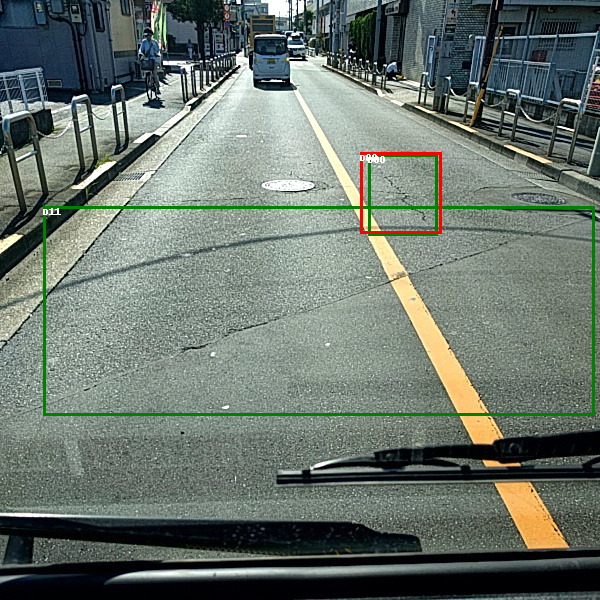

There is 1 road crack in this image
TP 1
FP 0
FN 1
TN 19
Infer Time is 5.07 second
34 predictions are done
IOU of the bounding box of detected crack is
IOU: 0.8208
-----------------------------------------------------------------------------


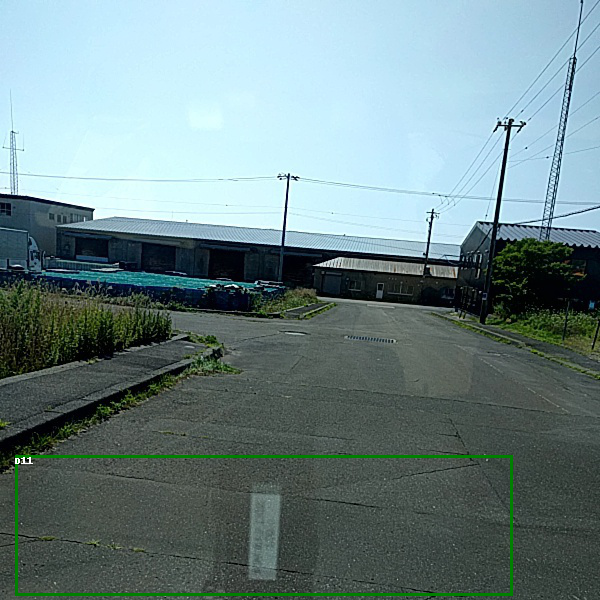

There is 1 road crack in this image
TP 0
FP 1
FN 1
TN 27
Infer Time is 5.01 second
35 predictions are done
-----------------------------------------------------------------------------


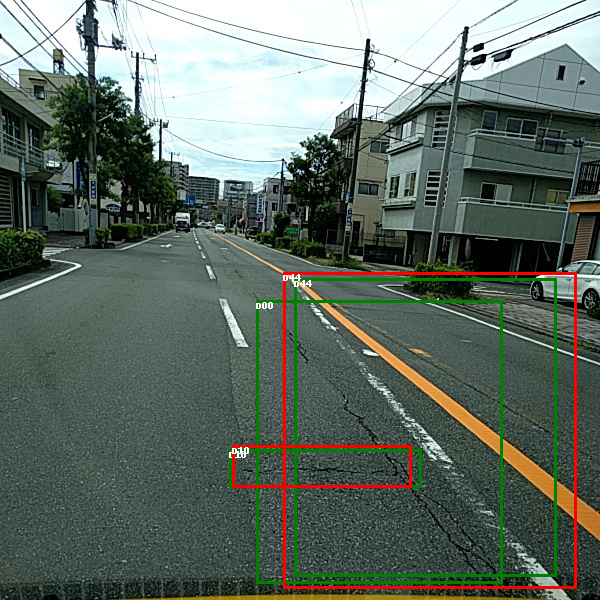

There are 3 road cracks in this image
TP 2
FP 1
FN 1
TN 17
Infer Time is 4.99 second
36 predictions are done
IOUs of the bounding boxes of detected cracks are
IOU: 0.8424
IOU: 0.8515
-----------------------------------------------------------------------------


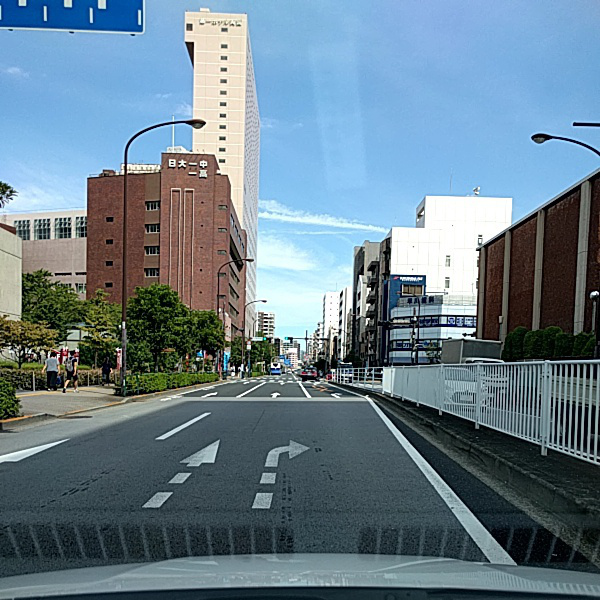

There is no crack
TP 0
FP 0
FN 0
TN 14
Infer Time is 5.05 second
37 predictions are done
-----------------------------------------------------------------------------


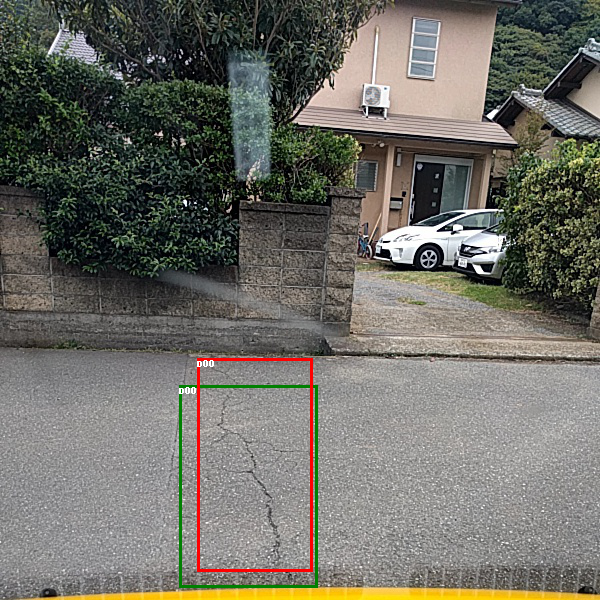

There is 1 road crack in this image
TP 1
FP 0
FN 0
TN 1
Infer Time is 5.01 second
38 predictions are done
IOU of the bounding box of detected crack is
IOU: 0.6945
-----------------------------------------------------------------------------


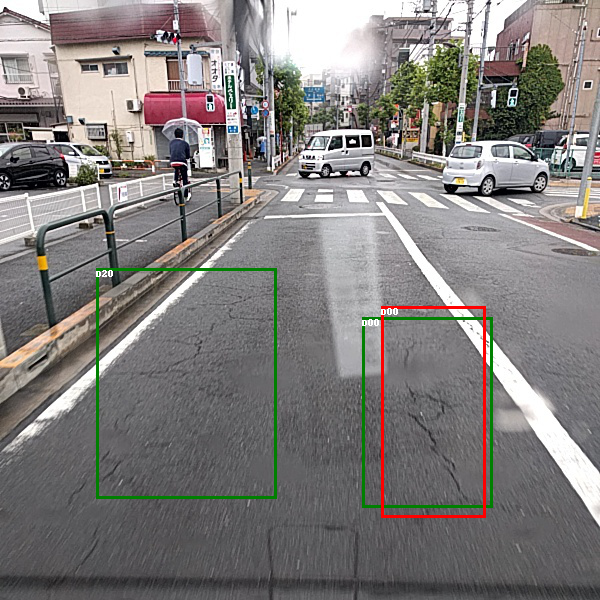

There are 5 road cracks in this image
TP 1
FP 4
FN 1
TN 11
Infer Time is 5.02 second
39 predictions are done
IOU of the bounding box of detected crack is
IOU: 0.7354
-----------------------------------------------------------------------------


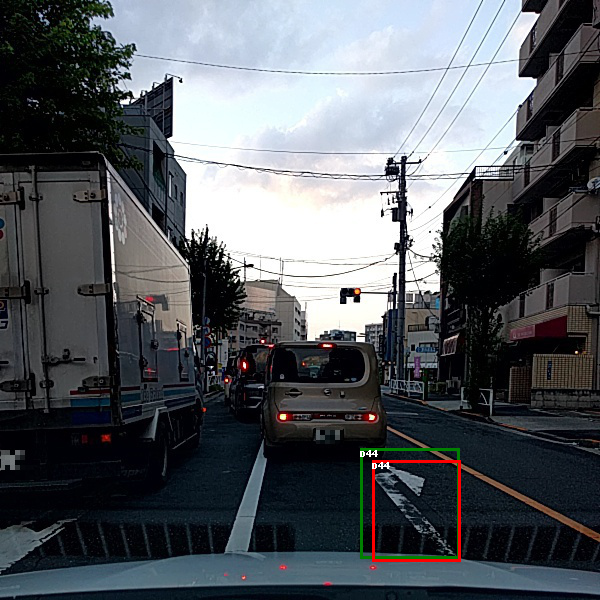

There is 1 road crack in this image
TP 1
FP 0
FN 0
TN 1
Infer Time is 5.08 second
40 predictions are done
IOU of the bounding box of detected crack is
IOU: 0.7449
-----------------------------------------------------------------------------


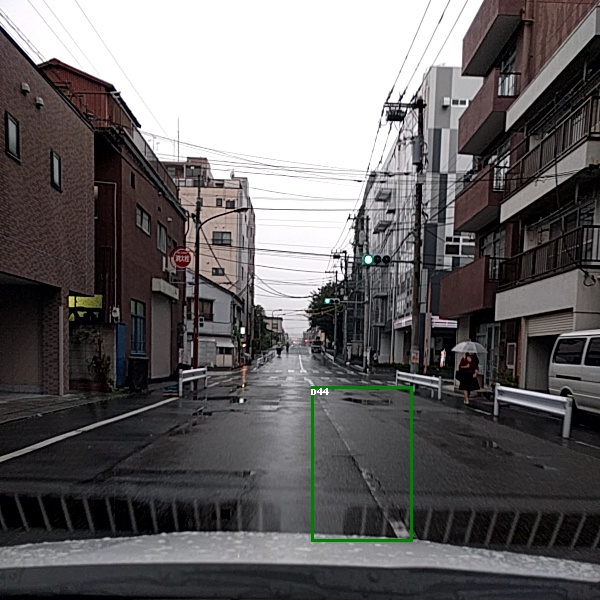

There are 2 road cracks in this image
TP 0
FP 2
FN 1
TN 12
Infer Time is 5.02 second
41 predictions are done
-----------------------------------------------------------------------------


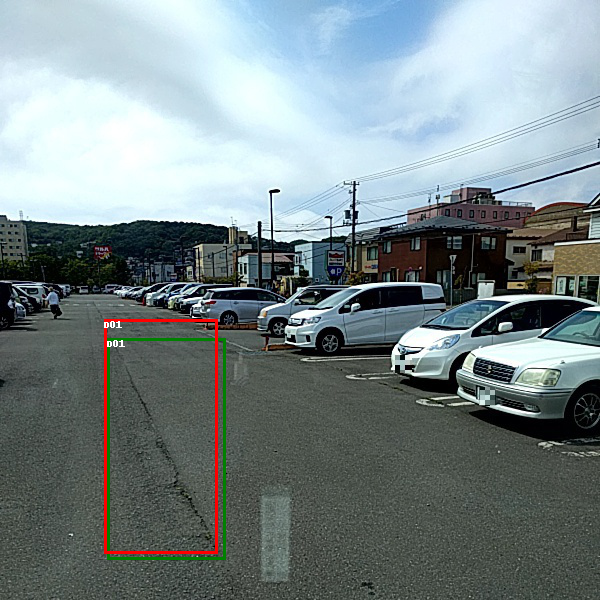

There is 1 road crack in this image
TP 1
FP 0
FN 0
TN 1
Infer Time is 5.15 second
42 predictions are done
IOU of the bounding box of detected crack is
IOU: 0.8291
-----------------------------------------------------------------------------


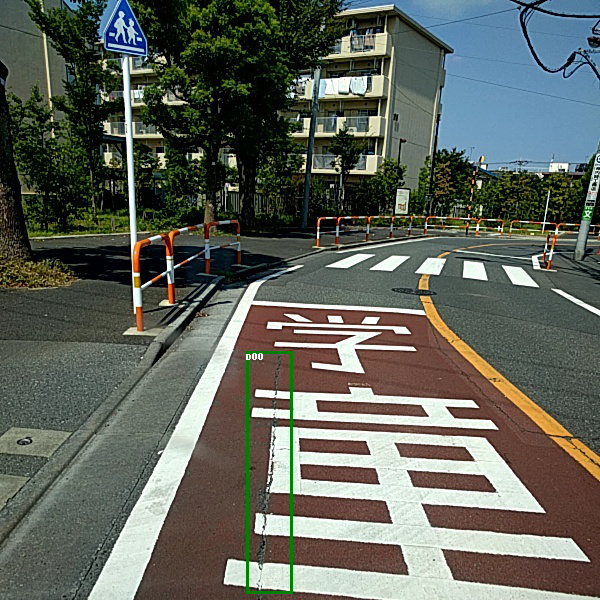

There are 2 road cracks in this image
TP 0
FP 2
FN 1
TN 6
Infer Time is 5.03 second
43 predictions are done
-----------------------------------------------------------------------------


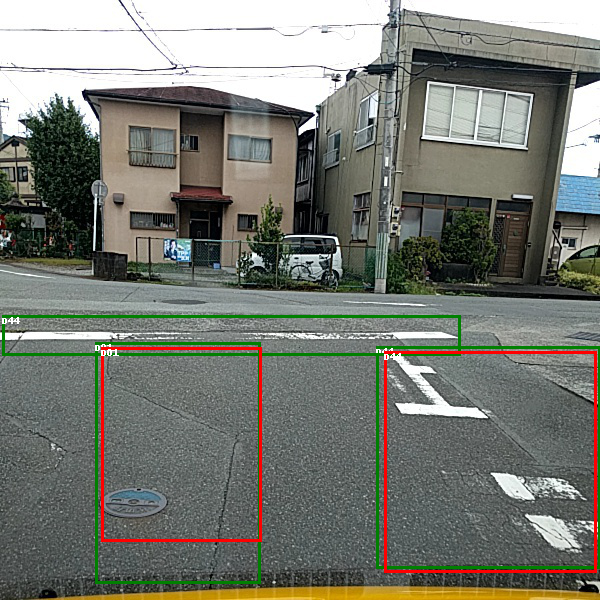

There are 4 road cracks in this image
TP 2
FP 2
FN 1
TN 13
Infer Time is 4.99 second
44 predictions are done
IOUs of the bounding boxes of detected cracks are
IOU: 0.9077
IOU: 0.7714
-----------------------------------------------------------------------------


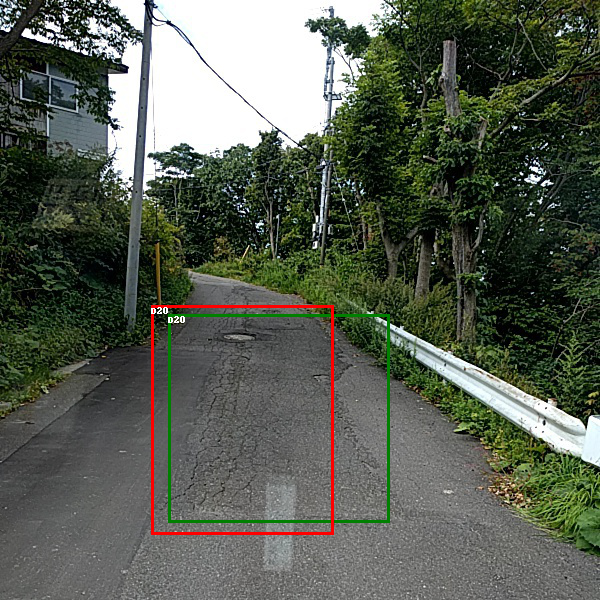

There is 1 road crack in this image
TP 1
FP 0
FN 0
TN 2
Infer Time is 5.04 second
45 predictions are done
IOU of the bounding box of detected crack is
IOU: 0.6515
-----------------------------------------------------------------------------


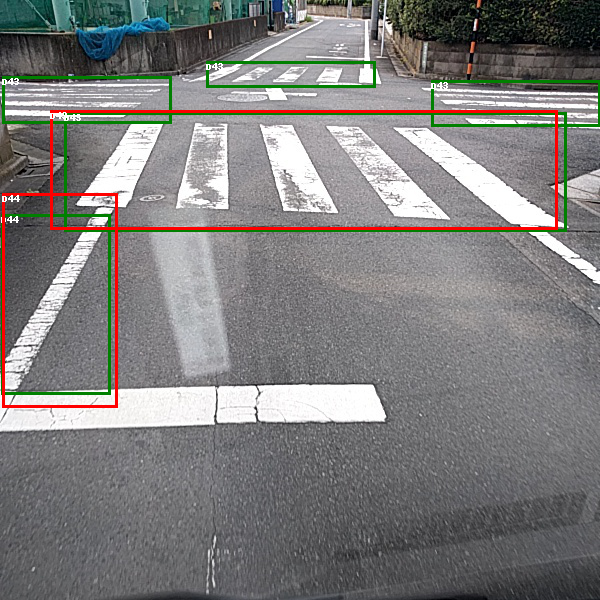

There are 3 road cracks in this image
TP 2
FP 1
FN 3
TN 16
Infer Time is 5.07 second
46 predictions are done
IOUs of the bounding boxes of detected cracks are
IOU: 0.9326
IOU: 0.7738
-----------------------------------------------------------------------------


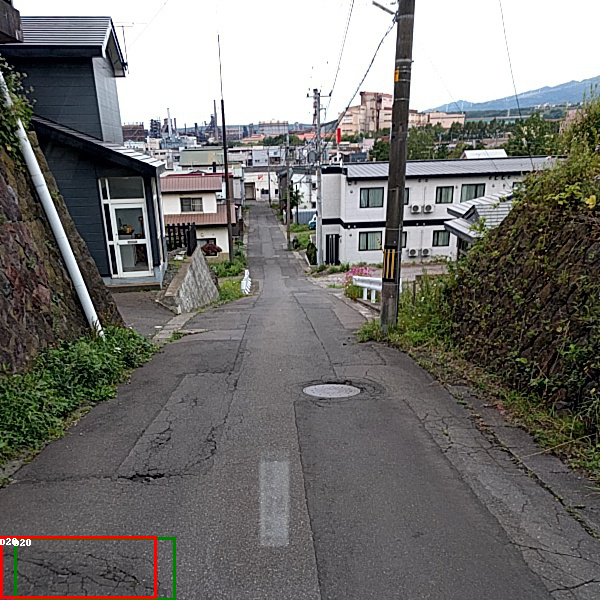

There are 2 road cracks in this image
TP 1
FP 1
FN 0
TN 25
Infer Time is 5.01 second
47 predictions are done
IOU of the bounding box of detected crack is
IOU: 0.7925
-----------------------------------------------------------------------------


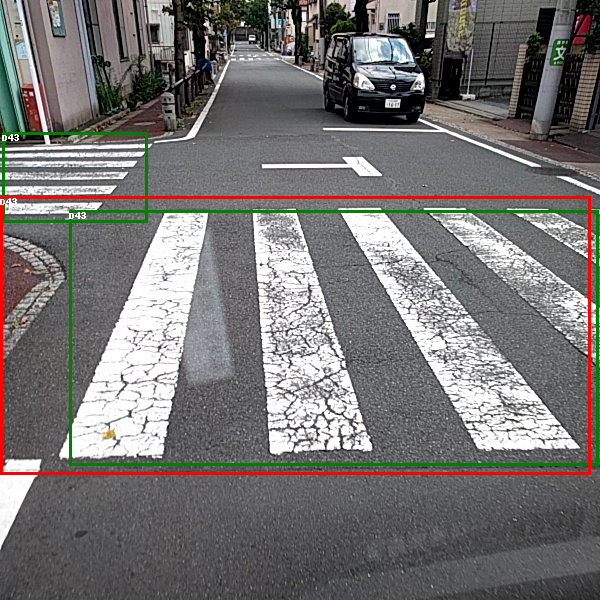

There is 1 road crack in this image
TP 1
FP 0
FN 1
TN 7
Infer Time is 5.09 second
48 predictions are done
IOU of the bounding box of detected crack is
IOU: 0.8015
-----------------------------------------------------------------------------


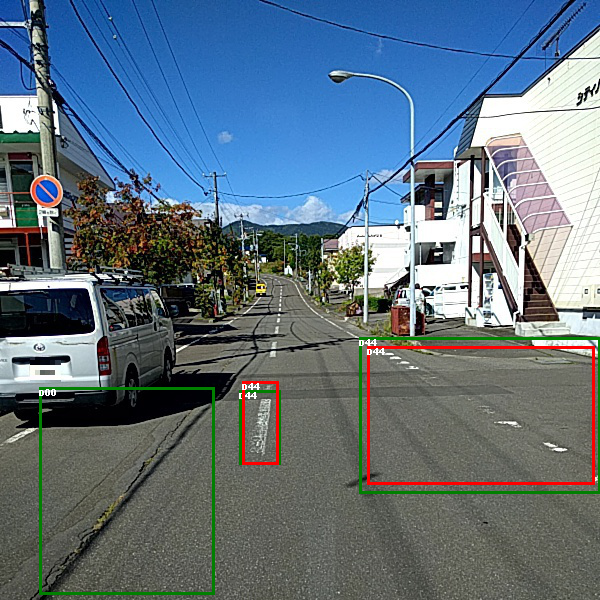

There are 2 road cracks in this image
TP 2
FP 0
FN 1
TN 9
Infer Time is 5.10 second
49 predictions are done
IOUs of the bounding boxes of detected cracks are
IOU: 0.7903
IOU: 0.8343
-----------------------------------------------------------------------------


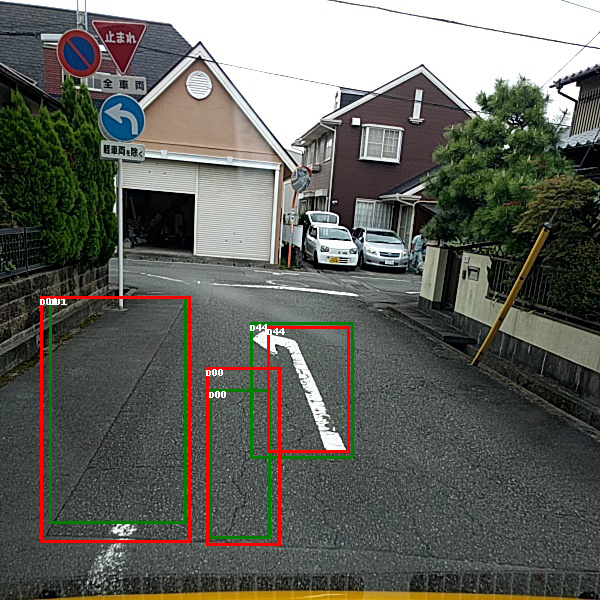

There are 3 road cracks in this image
TP 3
FP 0
FN 0
TN 10
Infer Time is 5.02 second
50 predictions are done
IOUs of the bounding boxes of detected cracks are
IOU: 0.839
IOU: 0.7418
IOU: 0.6935
-----------------------------------------------------------------------------
There are 66 cracks in 50 tested images
Confusion Matrix:
True Postive is 66
True Negative is 501
False Postive is 33
False Negative is 28
Accuracy is 0.9029
Precision is 0.6667
Recall is 0.7021
F1 score 0.6839
D00 Recall is 0.4615
D00 Precision is 0.4286
D00 Accuracy is 0.8696
D00 F1 score is 0.4444
D01 Recall is 0.7917
D01 Precision is 0.6333
D01 Accuracy is 0.8545
D01 F1 score is 0.7037
D10 Recall is 0.6667
D10 Precision is 1.0
D10 Accuracy is 0.9744
D10 F1 score is 0.8
D11 Recall is 0.0
D11 Precision is 0.0
D11 Accuracy is 0.9247
D11 F1 score is 0.0
D20 Recall is 0.8333
D20 Precision is 0.7143
D20 Accuracy is 0.9167
D20 F1 score is 0.7692
D30 Recall is 0
D30 Precision is 0
D30 Accuracy is 1.0
D30 F1 score is 0
D40 

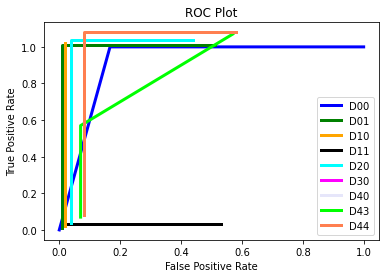

In [ ]:
from PIL import Image, ImageFont, ImageDraw
from IOU import get_iou
import matplotlib.pyplot as plt
import time

loaded_model = get_model(num_classes=10)
loaded_model.load_state_dict(torch.load("/content/drive/My Drive/Models/model_10_class"))


def getTPR_FPR(TP, TN, FP, FN):
    TPR = 0
    FPR = 0
    if (TP == 0 and FN == 0):
        pass
    else:
        TPR = TP / (TP + FN)

    if (TN == 0 and FP == 0):
        pass
    else:
        FPR = FP / (TN + FP)

    return TPR, FPR


# calculate recall, precision, accuracy and F1 score
def getEval(TP, TN, FP, FN):
    REC = 0
    PRE = 0
    ACU = 0
    FSO = 0

    if (TP == 0 and FN == 0):
        pass
    else:
        REC = TP / (TP + FN)

    if (TP == 0 and FP == 0):
        pass
    else:
        PRE = TP / (TP + FP)

    if (TP == 0 and TN == 0 and FP == 0 and FN == 0):
        pass
    else:
        ACU = (TP+TN) / (TP+TN+FP+FN)
        
    if (TP == 0 and FP == 0 and FN == 0):
        pass
    else:
        FSO = (2*TP) / ((2*TP)+FP+FN)

    return REC, PRE, ACU, FSO


# remove the same element from the list
# to be used to check false negative
def remove_items_from_list(my_list, temp):
    dup_list = [item for item in temp if item in my_list]

    for ele in dup_list:
        my_list.remove(ele)

    return my_list


# convert class number to class name
def get_class_name(class_number_input):
    class_name = ''
    if (class_number_input == 1):
        class_name = 'D00'
    elif (class_number_input == 2):
        class_name = 'D01'
    elif (class_number_input == 3):
        class_name = 'D10'
    elif (class_number_input == 4):
        class_name = 'D11'
    elif (class_number_input == 5):
        class_name = 'D20'
    elif (class_number_input == 6):
        class_name = 'D30'
    elif (class_number_input == 7):
        class_name = 'D40'
    elif (class_number_input == 8):
        class_name = 'D43'
    elif (class_number_input == 9):
        class_name = 'D44'
    else:
        class_name = 'NO'

    return class_name


# visualising image and getting data for confusion matrix
def visual_image(index_of_image):
    num_total_cracks = 0
    num_cracks = 0
    num_passed_iou = 0
    TP = 0
    FP = 0
    FN = 0
    TN = 0
    Precision = 0
    Recall = 0
    FPR = 0
    F1_score = 0
    iou_array = []
    iou_passed_class_array = []
    groundtruth_class_array = []
    extra_FP = 0
    D00_TP = 0
    D01_TP = 0
    D10_TP = 0
    D11_TP = 0
    D20_TP = 0
    D30_TP = 0
    D40_TP = 0
    D43_TP = 0
    D44_TP = 0
    NO_TP = 0
    D00_TN = 0
    D01_TN = 0
    D10_TN = 0
    D11_TN = 0
    D20_TN = 0
    D30_TN = 0
    D40_TN = 0
    D43_TN = 0
    D44_TN = 0
    NO_TN = 0
    D00_FP = 0
    D01_FP = 0
    D10_FP = 0
    D11_FP = 0
    D20_FP = 0
    D30_FP = 0
    D40_FP = 0
    D43_FP = 0
    D44_FP = 0
    NO_FP = 0
    D00_FN = 0
    D01_FN = 0
    D10_FN = 0
    D11_FN = 0
    D20_FN = 0
    D30_FN = 0
    D40_FN = 0
    D43_FN = 0
    D44_FN = 0
    NO_FN = 0
    D00_TPR = 0
    D01_TPR = 0
    D10_TPR = 0
    D11_TPR = 0
    D20_TPR = 0
    D30_TPR = 0
    D40_TPR = 0
    D43_TPR = 0
    D44_TPR = 0
    NO_TPR = 0
    D00_FPR = 0
    D01_FPR = 0
    D10_FPR = 0
    D11_FPR = 0
    D20_FPR = 0
    D30_FPR = 0
    D40_FPR = 0
    D43_FPR = 0
    D44_FPR = 0
    NO_FPR = 0

    # to calculate inference time
    start_test = time.time()
    img, _ = dataset_test[index_of_image]
    label_boxes = np.array(dataset_test[index_of_image][1]["boxes"])
    label_classes = np.array(dataset_test[index_of_image][1]["labels"])
    # print(label_classes)
    class_list = label_classes.tolist()

    # put the model in evaluation mode
    loaded_model.eval()

    with torch.no_grad():
        prediction = loaded_model([img])

    end_test = time.time()

    # print(prediction)
    pred_class_list = prediction[0]["labels"].tolist()
    # print(pred_class_list)

    image = Image.fromarray(img.mul(255).permute(1, 2, 0).byte().numpy())
    draw = ImageDraw.Draw(image)

    num_groundtruth_obj = len(label_boxes)

    # draw groundtruth
    for elem in range(len(label_boxes)):
        # print(label_boxes)
        # print('Ground Truth Class', label_classes[elem])
        draw.rectangle([(label_boxes[elem][0], label_boxes[elem][1]), (label_boxes[elem][2], label_boxes[elem][3])],
                       outline="green", width=3)
        draw.text((label_boxes[elem][0], label_boxes[elem][1]), text=str(get_class_name(class_list[elem])))
        groundtruth_class_array.append(class_list[elem])

    for element in range(len(prediction[0]["boxes"])):
        # print(prediction[0]["boxes"])
        boxes = prediction[0]["boxes"][element].cpu().numpy()
        confidence = np.round(prediction[0]["scores"][element].cpu().numpy(), decimals=4)
        # print(prediction[0]["boxes"][element])

        # checking confidence
        if confidence >= 0.7:
            # draw.rectangle([(boxes[0], boxes[1]), (boxes[2], boxes[3])], outline="blue", width=3)
            # draw.text((boxes[0], boxes[1]), text=(get_class_name(pred_class_list[element])))
            # print(get_class_name(pred_class_list[element]))
            prediction_class_element = pred_class_list[element]
            # print('Prediction Class', prediction_class_element)
            num_cracks += 1
            num_total_cracks += 1

            max_iou = 0
            class_name_checking = ''

            # checking IOU
            for box in range(len(label_boxes)):
                draft_cal_iou = get_iou(prediction[0]["boxes"][element], label_boxes[box])
                cal_iou = draft_cal_iou.data.cpu().numpy()
                if (cal_iou > max_iou):
                    max_iou = cal_iou
                    class_name_checking = class_list[box]
                    # print('max_iou', max_iou)

            # checking class label to meet all criteria to be a true positive
            if (max_iou >= 0.5 and prediction_class_element == class_name_checking):
                num_passed_iou += 1
                iou_array.append(max_iou)
                iou_passed_class_array.append(pred_class_list[element])
                draw.rectangle([(boxes[0], boxes[1]), (boxes[2], boxes[3])], outline="red", width=3)
                draw.text((boxes[0], boxes[1]), text=(get_class_name(pred_class_list[element])))
                if (pred_class_list[element] == 1):
                    D00_TP += 1
                elif (pred_class_list[element] == 2):
                    D01_TP += 1
                elif (pred_class_list[element] == 3):
                    D10_TP += 1
                elif (pred_class_list[element] == 4):
                    D11_TP += 1
                elif (pred_class_list[element] == 5):
                    D20_TP += 1
                elif (pred_class_list[element] == 6):
                    D30_TP += 1
                elif (pred_class_list[element] == 7):
                    D40_TP += 1
                elif (pred_class_list[element] == 8):
                    D43_TP += 1
                elif (pred_class_list[element] == 9):
                    D44_TP += 1
                else:
                    NO_TP += 1
            else:
                # confidence is above 0.7 but it did not pass IOU and class label check
                if (pred_class_list[element] == 1):
                    D00_FP += 1
                elif (pred_class_list[element] == 2):
                    D01_FP += 1
                elif (pred_class_list[element] == 3):
                    D10_FP += 1
                elif (pred_class_list[element] == 4):
                    D11_FP += 1
                elif (pred_class_list[element] == 5):
                    D20_FP += 1
                elif (pred_class_list[element] == 6):
                    D30_FP += 1
                elif (pred_class_list[element] == 7):
                    D40_FP += 1
                elif (pred_class_list[element] == 8):
                    D43_FP += 1
                elif (pred_class_list[element] == 9):
                    D44_FP += 1
                else:
                    NO_FP += 1
        else:
            # confidence below 0.7
            TN += 1
            if (pred_class_list[element] == 1):
                D00_TN += 1
            elif (pred_class_list[element] == 2):
                D01_TN += 1
            elif (pred_class_list[element] == 3):
                D10_TN += 1
            elif (pred_class_list[element] == 4):
                D11_TN += 1
            elif (pred_class_list[element] == 5):
                D20_TN += 1
            elif (pred_class_list[element] == 6):
                D30_TN += 1
            elif (pred_class_list[element] == 7):
                D40_TN += 1
            elif (pred_class_list[element] == 8):
                D43_TN += 1
            elif (pred_class_list[element] == 9):
                D44_TN += 1
            else:
                NO_TN += 1

    # to check the possible extra false postive from true postive where the number of ground truch bounding box is lower than true positive
    if (num_passed_iou > num_groundtruth_obj):
        extra_FP = num_passed_iou - num_groundtruth_obj
        FN = 0
    else:
        FN = num_groundtruth_obj - num_passed_iou
    if (num_passed_iou > num_groundtruth_obj):
        extra_FP = num_passed_iou - num_groundtruth_obj
        TP = num_passed_iou - extra_FP
    else:
        TP = num_passed_iou

    FP = (num_cracks - num_passed_iou) + extra_FP

    if (extra_FP > 0):
        extra_FP_array = remove_items_from_list(iou_passed_class_array, groundtruth_class_array)
        # print('extra FP')
        # print(extra_FP_array)
        for element in range(len(extra_FP_array)):
            if (extra_FP_array[element] == 1):
                D00_FP += 1
                D00_TP -= 1
            elif (extra_FP_array[element] == 2):
                D01_FP += 1
                D01_TP -= 1
            elif (extra_FP_array[element] == 3):
                D10_FP += 1
                D10_TP -= 1
            elif (extra_FP_array[element] == 4):
                D11_FP += 1
                D11_TP -= 1
            elif (extra_FP_array[element] == 5):
                D20_FP += 1
                D20_TP -= 1
            elif (extra_FP_array[element] == 6):
                D30_FP += 1
                D30_TP -= 1
            elif (extra_FP_array[element] == 7):
                D40_FP += 1
                D40_TP -= 1
            elif (extra_FP_array[element] == 8):
                D43_FP += 1
                D43_TP -= 1
            elif (extra_FP_array[element] == 9):
                D44_FP += 1
                D44_TP -= 1
            else:
                NO_FP += 1
                NO_TP -= 1

    # to get class label of false negative and record it into individual class false negative
    if (FN > 0):
        FN_array = remove_items_from_list(groundtruth_class_array, iou_passed_class_array)
        # print('FN is there')
        # print(FN_array)
        for element in range(len(FN_array)):
            if (FN_array[element] == 1):
                D00_FN += 1
            elif (FN_array[element] == 2):
                D01_FN += 1
            elif (FN_array[element] == 3):
                D10_FN += 1
            elif (FN_array[element] == 4):
                D11_FN += 1
            elif (FN_array[element] == 5):
                D20_FN += 1
            elif (FN_array[element] == 6):
                D30_FN += 1
            elif (FN_array[element] == 7):
                D40_FN += 1
            elif (FN_array[element] == 8):
                D43_FN += 1
            elif (FN_array[element] == 9):
                D44_FN += 1
            else:
                NO_FN += 1

    if ((TP == 0 and FP == 0) or (TP == 0 and FN == 0) or (TN == 0 and FP == 0)):
        pass
    else:
        Precision = TP / (TP + FP)
        Recall = TP / (TP + FN)
        FPR = FP / (TN + FP)

    if (Precision == 0 and Recall == 0):
        pass
    else:
        F1_score = 2 * ((Precision * Recall) / (Precision + Recall))

    # calculate true positive rate and false positive rate for each class
    D00_TPR, D00_FPR = getTPR_FPR(D00_TP, D00_TN, D00_FP, D00_FN)
    D01_TPR, D01_FPR = getTPR_FPR(D01_TP, D01_TN, D01_FP, D01_FN)
    D10_TPR, D10_FPR = getTPR_FPR(D10_TP, D10_TN, D10_FP, D10_FN)
    D11_TPR, D11_FPR = getTPR_FPR(D11_TP, D11_TN, D11_FP, D11_FN)
    D20_TPR, D20_FPR = getTPR_FPR(D20_TP, D20_TN, D20_FP, D20_FN)
    D30_TPR, D30_FPR = getTPR_FPR(D30_TP, D30_TN, D30_FP, D30_FN)
    D40_TPR, D40_FPR = getTPR_FPR(D40_TP, D40_TN, D40_FP, D40_FN)
    D43_TPR, D43_FPR = getTPR_FPR(D43_TP, D43_TN, D43_FP, D43_FN)
    D44_TPR, D44_FPR = getTPR_FPR(D44_TP, D44_TN, D44_FP, D44_FN)
    NO_TPR, NO_FPR = getTPR_FPR(NO_TP, NO_TN, NO_FP, NO_FN)

    # display the image
    display(image)

    # output message
    if num_cracks == 1:
        print('There is', num_cracks, 'road crack in this image')
    elif num_cracks > 1:
        print('There are', num_cracks, 'road cracks in this image')
    else:
        print('There is no crack')

    infer_time = end_test - start_test

    print('TP', TP)
    print('FP', FP)
    print('FN', FN)
    print('TN', TN)
    print('Infer Time is %0.2f second' % infer_time)

    return infer_time, Recall, FPR, num_total_cracks, iou_array, TP, FP, FN, TN, D00_TPR, D01_TPR, D10_TPR, D11_TPR, D20_TPR, D30_TPR, D40_TPR, D43_TPR, D44_TPR, NO_TPR, D00_FPR, D01_FPR, D10_FPR, D11_FPR, D20_FPR, D30_FPR, D40_FPR, D43_FPR, D44_FPR, NO_FPR, D00_TP, D01_TP, D10_TP, D11_TP, D20_TP, D30_TP, D40_TP, D43_TP, D44_TP, NO_TP, D00_TN, D01_TN, D10_TN, D11_TN, D20_TN, D30_TN, D40_TN, D43_TN, D44_TN, NO_TN, D00_FP, D01_FP, D10_FP, D11_FP, D20_FP, D30_FP, D40_FP, D43_FP, D44_FP, NO_FP, D00_FN, D01_FN, D10_FN, D11_FN, D20_FN, D30_FN, D40_FN, D43_FN, D44_FN, NO_FN



def main():
    total = 0
    Precision = 0
    TPR_Recall = 0
    TPR_array = []
    FPR_array = []
    D00_TPR_array = []
    D00_FPR_array = []
    D01_TPR_array = []
    D01_FPR_array = []
    D10_TPR_array = []
    D10_FPR_array = []
    D11_TPR_array = []
    D11_FPR_array = []
    D20_TPR_array = []
    D20_FPR_array = []
    D30_TPR_array = []
    D30_FPR_array = []
    D40_TPR_array = []
    D40_FPR_array = []
    D43_TPR_array = []
    D43_FPR_array = []
    D44_TPR_array = []
    D44_FPR_array = []
    F1_score = 0
    input_Recall = 0
    input_FPR = 0
    TP = 0
    FP = 0
    FN = 0
    TN = 0
    Total_D00_TP = 0
    Total_D01_TP = 0
    Total_D10_TP = 0
    Total_D11_TP = 0
    Total_D20_TP = 0
    Total_D30_TP = 0
    Total_D40_TP = 0
    Total_D43_TP = 0
    Total_D44_TP = 0
    Total_NO_TP = 0
    Total_D00_TN = 0
    Total_D01_TN = 0
    Total_D10_TN = 0
    Total_D11_TN = 0
    Total_D20_TN = 0
    Total_D30_TN = 0
    Total_D40_TN = 0
    Total_D43_TN = 0
    Total_D44_TN = 0
    Total_NO_TN = 0
    Total_D00_FP = 0
    Total_D01_FP = 0
    Total_D10_FP = 0
    Total_D11_FP = 0
    Total_D20_FP = 0
    Total_D30_FP = 0
    Total_D40_FP = 0
    Total_D43_FP = 0
    Total_D44_FP = 0
    Total_NO_FP = 0
    Total_D00_FN = 0
    Total_D01_FN = 0
    Total_D10_FN = 0
    Total_D11_FN = 0
    Total_D20_FN = 0
    Total_D30_FN = 0
    Total_D40_FN = 0
    Total_D43_FN = 0
    Total_D44_FN = 0
    Total_NO_FN = 0
    total_infer_time = 0
    all_tests = len(dataset_test)
    # some_tests = 20

    for index in range(all_tests):

        # get all recorded information and combine all values for each
        infer_time, each_Recall, each_FPR, num_total_cracks, iou_array, each_TP, each_FP, each_FN, each_TN, D00_TPR, D01_TPR, D10_TPR, D11_TPR, D20_TPR, D30_TPR, D40_TPR, D43_TPR, D44_TPR, NO_TPR, D00_FPR, D01_FPR, D10_FPR, D11_FPR, D20_FPR, D30_FPR, D40_FPR, D43_FPR, D44_FPR, NO_FPR, D00_TP, D01_TP, D10_TP, D11_TP, D20_TP, D30_TP, D40_TP, D43_TP, D44_TP, NO_TP, D00_TN, D01_TN, D10_TN, D11_TN, D20_TN, D30_TN, D40_TN, D43_TN, D44_TN, NO_TN, D00_FP, D01_FP, D10_FP, D11_FP, D20_FP, D30_FP, D40_FP, D43_FP, D44_FP, NO_FP, D00_FN, D01_FN, D10_FN, D11_FN, D20_FN, D30_FN, D40_FN, D43_FN, D44_FN, NO_FN = visual_image(index)
        total_infer_time += infer_time
        total += num_total_cracks
        input_Recall += each_Recall
        input_FPR += each_FPR
        TPR_array.append(each_Recall)
        FPR_array.append(each_FPR)
        D00_TPR_array.append(D00_TPR)
        D00_FPR_array.append(D00_FPR)
        D01_TPR_array.append(D01_TPR + 0.01)
        D01_FPR_array.append(D01_FPR + 0.01)
        D10_TPR_array.append(D10_TPR + 0.02)
        D10_FPR_array.append(D10_FPR + 0.02)
        D11_TPR_array.append(D11_TPR + 0.03)
        D11_FPR_array.append(D11_FPR + 0.03)
        D20_TPR_array.append(D20_TPR + 0.04)
        D20_FPR_array.append(D20_FPR + 0.04)
        D30_TPR_array.append(D30_TPR + 0.05)
        D30_FPR_array.append(D30_FPR + 0.05)
        D40_TPR_array.append(D40_TPR + 0.06)
        D40_FPR_array.append(D40_FPR + 0.06)
        D43_TPR_array.append(D43_TPR + 0.07)
        D43_FPR_array.append(D43_FPR + 0.07)
        D44_TPR_array.append(D44_TPR + 0.08)
        D44_FPR_array.append(D44_FPR + 0.08)
        TP += each_TP
        FP += each_FP
        FN += each_FN
        TN += each_TN
        Total_D00_TP += D00_TP
        Total_D01_TP += D01_TP
        Total_D10_TP += D10_TP
        Total_D11_TP += D11_TP
        Total_D20_TP += D20_TP
        Total_D30_TP += D30_TP
        Total_D40_TP += D40_TP
        Total_D43_TP += D43_TP
        Total_D44_TP += D44_TP
        Total_NO_TP  += NO_TP
        Total_D00_TN += D00_TN
        Total_D01_TN += D01_TN
        Total_D10_TN += D10_TN
        Total_D11_TN += D11_TN
        Total_D20_TN += D20_TN
        Total_D30_TN += D30_TN
        Total_D40_TN += D40_TN
        Total_D43_TN += D43_TN
        Total_D44_TN += D44_TN
        Total_NO_TN += NO_TN
        Total_D00_FP += D00_FP
        Total_D01_FP += D01_FP
        Total_D10_FP += D10_FP
        Total_D11_FP += D11_FP
        Total_D20_FP += D20_FP
        Total_D30_FP += D30_FP
        Total_D40_FP += D40_FP
        Total_D43_FP += D43_FP
        Total_D44_FP += D44_FP
        Total_NO_FP += NO_FP
        Total_D00_FN += D00_FN
        Total_D01_FN += D01_FN
        Total_D10_FN += D10_FN
        Total_D11_FN += D11_FN
        Total_D20_FN += D20_FN
        Total_D30_FN += D30_FN
        Total_D40_FN += D40_FN
        Total_D43_FN += D43_FN
        Total_D44_FN += D44_FN
        Total_NO_FN += NO_FN

        # calculate recall, precision, accuracy and F1 score for each class
        D00_Recall, D00_Precision, D00_Accuracy, D00_F1_Score = getEval(Total_D00_TP, Total_D00_TN, Total_D00_FP, Total_D00_FN)
        D01_Recall, D01_Precision, D01_Accuracy, D01_F1_Score = getEval(Total_D01_TP, Total_D01_TN, Total_D01_FP, Total_D01_FN)
        D10_Recall, D10_Precision, D10_Accuracy, D10_F1_Score = getEval(Total_D10_TP, Total_D10_TN, Total_D10_FP, Total_D10_FN)
        D11_Recall, D11_Precision, D11_Accuracy, D11_F1_Score = getEval(Total_D11_TP, Total_D11_TN, Total_D11_FP, Total_D11_FN)
        D20_Recall, D20_Precision, D20_Accuracy, D20_F1_Score = getEval(Total_D20_TP, Total_D20_TN, Total_D20_FP, Total_D20_FN)
        D30_Recall, D30_Precision, D30_Accuracy, D30_F1_Score = getEval(Total_D30_TP, Total_D30_TN, Total_D30_FP, Total_D30_FN)
        D40_Recall, D40_Precision, D40_Accuracy, D40_F1_Score = getEval(Total_D40_TP, Total_D40_TN, Total_D40_FP, Total_D40_FN)
        D43_Recall, D43_Precision, D43_Accuracy, D43_F1_Score = getEval(Total_D43_TP, Total_D43_TN, Total_D43_FP, Total_D43_FN)
        D44_Recall, D44_Precision, D44_Accuracy, D44_F1_Score = getEval(Total_D44_TP, Total_D44_TN, Total_D44_FP, Total_D44_FN)
        
        # output message
        if index > 0:
            print(index + 1, 'predictions are done')
        else:
            print(index + 1, 'prediction is done')

        if len(iou_array) <= 0:
            pass
        elif len(iou_array) == 1:
            print('IOU of the bounding box of detected crack is')
        else:
            print('IOUs of the bounding boxes of detected cracks are')

        for ind in range(len(iou_array)):
            iou = float(iou_array[ind])
            print('IOU:', round(iou, 4))

        print('-----------------------------------------------------------------------------')

    if ((TP == 0 and FP == 0) or (TP == 0 and FN == 0) or (TN == 0 and FP == 0)):
        pass
    else:
        Precision = TP / (TP + FP)
        TPR_Recall = TP / (TP + FN)
        FPR = FP / (TN + FP)

    if (Precision == 0 and TPR_Recall == 0):
        pass
    else:
        F1_score = 2 * ((Precision * TPR_Recall) / (Precision + TPR_Recall))
    total_CM = TP + TN + FP + FN
    model_accuracy = (TP + TN) / total_CM


    # output message for the whole testing
    print('There are', TP, 'cracks in', len(dataset_test), 'tested images')
    print('Confusion Matrix:')
    print('True Postive is', round(TP, 4))
    print('True Negative is', round(TN, 4))
    print('False Postive is', round(FP, 4))
    print('False Negative is', round(FN, 4))
    print('Accuracy is', round(model_accuracy, 4))
    print('Precision is', round(Precision, 4))
    print('Recall is', round(TPR_Recall, 4))
    print('F1 score', round(F1_score, 4))
    print('D00 Recall is', round(D00_Recall, 4))
    print('D00 Precision is', round(D00_Precision, 4))
    print('D00 Accuracy is', round(D00_Accuracy, 4))
    print('D00 F1 score is', round(D00_F1_Score, 4))
    print('D01 Recall is', round(D01_Recall, 4))
    print('D01 Precision is', round(D01_Precision, 4))
    print('D01 Accuracy is', round(D01_Accuracy, 4))
    print('D01 F1 score is', round(D01_F1_Score, 4))
    print('D10 Recall is', round(D10_Recall, 4))
    print('D10 Precision is', round(D10_Precision, 4))
    print('D10 Accuracy is', round(D10_Accuracy, 4))
    print('D10 F1 score is', round(D10_F1_Score, 4))
    print('D11 Recall is', round(D11_Recall, 4))
    print('D11 Precision is', round(D11_Precision, 4))
    print('D11 Accuracy is', round(D11_Accuracy, 4))
    print('D11 F1 score is', round(D11_F1_Score, 4))
    print('D20 Recall is', round(D20_Recall, 4))
    print('D20 Precision is', round(D20_Precision, 4))
    print('D20 Accuracy is', round(D20_Accuracy, 4))
    print('D20 F1 score is', round(D20_F1_Score, 4))
    print('D30 Recall is', round(D30_Recall, 4))
    print('D30 Precision is', round(D30_Precision, 4))
    print('D30 Accuracy is', round(D30_Accuracy, 4))
    print('D30 F1 score is', round(D30_F1_Score, 4))
    print('D40 Recall is', round(D40_Recall, 4))
    print('D40 Precision is', round(D40_Precision, 4))
    print('D40 Accuracy is', round(D40_Accuracy, 4))
    print('D40 F1 score is', round(D40_F1_Score, 4))
    print('D43 Recall is', round(D43_Recall, 4))
    print('D43 Precision is', round(D43_Precision, 4))
    print('D43 Accuracy is', round(D43_Accuracy, 4))
    print('D43 F1 score is', round(D43_F1_Score, 4))
    print('D44 Recall is', round(D44_Recall, 4))
    print('D44 Precision is', round(D44_Precision, 4))
    print('D44 Accuracy is', round(D44_Accuracy, 4))
    print('D44 F1 score is', round(D44_F1_Score, 4))
    print('Total Inference Time is %0.2f second' % total_infer_time)
    print('Average Inference Time is %0.2f second' % (total_infer_time/all_tests))

    TPR_array.sort()
    FPR_array.sort()
    D00_TPR_array.sort()
    D00_FPR_array.sort()
    D01_TPR_array.sort()
    D01_FPR_array.sort()
    D10_TPR_array.sort()
    D10_FPR_array.sort()
    D11_TPR_array.sort()
    D11_FPR_array.sort()
    D20_TPR_array.sort()
    D20_FPR_array.sort()
    D30_TPR_array.sort()
    D30_FPR_array.sort()
    D40_TPR_array.sort()
    D40_FPR_array.sort()
    D43_TPR_array.sort()
    D43_FPR_array.sort()
    D44_TPR_array.sort()
    D44_FPR_array.sort()

    # Title
    plt.title('ROC Plot')
    # Axis labels
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    # plt.plot(FPR_array, TPR_array)
    plt.plot(D00_FPR_array, D00_TPR_array, color='blue', linewidth=3, label='D00')
    plt.plot(D01_FPR_array, D01_TPR_array, color='green', linewidth=3, label='D01')
    plt.plot(D10_FPR_array, D10_TPR_array, color='orange', linewidth=3, label='D10')
    plt.plot(D11_FPR_array, D11_TPR_array, color='black', linewidth=3, label='D11')
    plt.plot(D20_FPR_array, D20_TPR_array, color='cyan', linewidth=3, label='D20')
    plt.plot(D30_FPR_array, D30_TPR_array, color='magenta', linewidth=3, label='D30')
    plt.plot(D40_FPR_array, D40_TPR_array, color='lavender', linewidth=3, label='D40')
    plt.plot(D43_FPR_array, D43_TPR_array, color='lime', linewidth=3, label='D43')
    plt.plot(D44_FPR_array, D44_TPR_array, color='coral', linewidth=3, label='D44')
    plt.legend()
    plt.show()


main()